目標
1.繪製出全球的感染與康復人數，以國家別區分。
2.利用地理資訊圖表繪製出全球的感染與康復人數。

In [11]:
#匯入所需模組
import numpy as np 
import pandas as pd 
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
pd.set_option('display.max_rows', None)
from plotly.subplots import make_subplots


In [15]:
#匯入資料
data = pd.read_csv("covid_19_data.csv")
print(data.head(20))
print(data.info())

    SNo ObservationDate  Province/State  Country/Region      Last Update  \
0     1      01/22/2020           Anhui  Mainland China  1/22/2020 17:00   
1     2      01/22/2020         Beijing  Mainland China  1/22/2020 17:00   
2     3      01/22/2020       Chongqing  Mainland China  1/22/2020 17:00   
3     4      01/22/2020          Fujian  Mainland China  1/22/2020 17:00   
4     5      01/22/2020           Gansu  Mainland China  1/22/2020 17:00   
5     6      01/22/2020       Guangdong  Mainland China  1/22/2020 17:00   
6     7      01/22/2020         Guangxi  Mainland China  1/22/2020 17:00   
7     8      01/22/2020         Guizhou  Mainland China  1/22/2020 17:00   
8     9      01/22/2020          Hainan  Mainland China  1/22/2020 17:00   
9    10      01/22/2020           Hebei  Mainland China  1/22/2020 17:00   
10   11      01/22/2020    Heilongjiang  Mainland China  1/22/2020 17:00   
11   12      01/22/2020           Henan  Mainland China  1/22/2020 17:00   
12   13     

In [13]:
#找尋有沒有重複
data1 = data.drop_duplicates(subset = None, keep = "first", inplace = False)
if data1.shape[1] == data.shape[1]:
    print("沒有重複")

沒有重複


In [14]:
# 尋找遺失值
print(data.isnull().sum())

SNo                    0
ObservationDate        0
Province/State     44313
Country/Region         0
Last Update            0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64


In [7]:
# Province/State 有遺失值44313筆
# 檢查訓練資料集中是否有遺失值 ?
def Missing_Counts(Data) : 
    missing = Data.isnull().sum()      
    missing.sort_values( ascending=False, inplace=True )  
    Missing_Count = pd.DataFrame( { 'Column Name':missing.index, 'Missing Count':missing.values } ) 
    Missing_Count[ 'Percentage(%)' ] = Missing_Count['Missing Count'].apply( lambda x: '{:.2%}'.format(x/Data.shape[0]))
    return  Missing_Count
print(Missing_Counts(data))

       Column Name  Missing Count Percentage(%)
0   Province/State          44313        28.35%
1        Recovered              0         0.00%
2           Deaths              0         0.00%
3        Confirmed              0         0.00%
4      Last Update              0         0.00%
5   Country/Region              0         0.00%
6  ObservationDate              0         0.00%
7              SNo              0         0.00%


In [8]:
# 補滿遺失值
data['Province/State'] = data['Province/State'].fillna('Unknown')
# 轉換為dtype為 int
data[['Confirmed','Deaths','Recovered']]=data[['Confirmed','Deaths','Recovered']].astype(int)
# 把Country/Region 欄位中的 Mainland China 改為 China
data['Country/Region']=data['Country/Region'].replace('Mainland China','China')
# 新增欄位 Active_case
data['Active_case']=data['Confirmed']-data['Deaths']-data['Recovered']
print(data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156292 entries, 0 to 156291
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   SNo              156292 non-null  int64 
 1   ObservationDate  156292 non-null  object
 2   Province/State   156292 non-null  object
 3   Country/Region   156292 non-null  object
 4   Last Update      156292 non-null  object
 5   Confirmed        156292 non-null  int32 
 6   Deaths           156292 non-null  int32 
 7   Recovered        156292 non-null  int32 
 8   Active_case      156292 non-null  int32 
dtypes: int32(4), int64(1), object(4)
memory usage: 8.3+ MB
None


    index     SNo ObservationDate Province/State       Country/Region  \
0  155534  155535      11/15/2020        Unknown          Afghanistan   
1  155535  155536      11/15/2020        Unknown              Albania   
2  155536  155537      11/15/2020        Unknown              Algeria   
3  155537  155538      11/15/2020        Unknown              Andorra   
4  155538  155539      11/15/2020        Unknown               Angola   
5  155539  155540      11/15/2020        Unknown  Antigua and Barbuda   
6  155540  155541      11/15/2020        Unknown            Argentina   
7  155541  155542      11/15/2020        Unknown              Armenia   
8  155542  155543      11/15/2020        Unknown              Austria   
9  155543  155544      11/15/2020        Unknown           Azerbaijan   

           Last Update  Confirmed  Deaths  Recovered  Active_case  
0  2020-11-16 05:25:57      43240    1617      35092         6531  
1  2020-11-16 05:25:57      27830     623      12889        

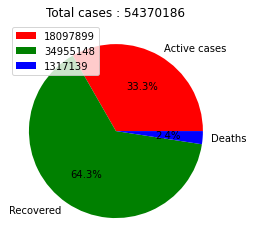

In [9]:
#最後所有國家的感染人數統計
Data = data[data['ObservationDate']==max(data['ObservationDate'])].reset_index()
print(Data.head(10))
print(Data.shape[0])
Data_world = Data[['Confirmed','Deaths','Recovered','Active_case']].groupby(Data['ObservationDate']).sum().reset_index()
print(Data_world)
labels=['Last Update','Confirmed','Deaths','Recovered','Active_case']
fig = go.Figure(data=[go.Table(header=dict(values=labels),
                                cells = dict(values=Data_world.loc[0,['ObservationDate','Confirmed','Deaths','Recovered','Active_case']]))
                    ])
fig.update_layout(title = 'Coronavirus in the word :',)
fig.show()
#  繪製圓餅圖
labels = ['Active cases','Recovered','Deaths']
#計算數字
values = Data_world.loc[0, ['Active_case','Recovered','Deaths']]
fig = px.pie(Data_world, values=values, names=labels,color_discrete_sequence=['rgb(77,146,33)','rgb(69,144,185)','rgb(77,77,77)'],hole=0.7)
fig.update_layout( title='Total cases : '+str(Data_world["Confirmed"][0]) )
fig.show()
plt.pie(values,labels=labels, colors=['r','g','b'],autopct='%.1f%%')
plt.legend(values,loc = 'upper left' )
plt.title('Total cases : 54370186')
plt.show()

In [10]:
# Evolution of coronavirus over time
data_overtime = data[['Confirmed','Deaths','Recovered','Active_case']].groupby(data['ObservationDate']).sum().reset_index().sort_values('ObservationDate',ascending=True).reset_index(drop=True)
print(data_overtime.head(5))
fig = go.Figure()
fig.add_trace( go.Scatter( x=data_overtime.index, y=data_overtime['Confirmed'], mode='lines', name = 'Confirmed cases' ) )

fig.update_layout( title='Evolution of Confirmed cases over time in the word',
                   template='plotly_white',
                   yaxis_title='Confirmed cases',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure()
fig.add_trace(go.Scatter(x=data_overtime.index, y = data_overtime['Deaths'], mode = 'lines',marker_color='black', line = dict(dash='dot')))
fig.update_layout( title='Evolution of Confirmed cases over time in the word',
                   template='plotly_white',
                   yaxis_title='Deaths cases',
                   xaxis_title='Days'
                 ) 
fig.show()
fig = go.Figure()
fig.add_trace( go.Scatter( x=data_overtime.index, y=data_overtime['Recovered'], mode='lines', name='Recovered cases', marker_color='green' ) )
fig.update_layout( title='Evolution of Recovered cases over time in the world',
                   template='plotly_white',
                   yaxis_title='Recovered cases',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure()
fig.add_trace( go.Scatter( x=data_overtime.index, y=data_overtime['Active_case'], mode='lines', marker_color='yellow', name='Active cases', line=dict(dash='dot')) )
fig.update_layout( title='Evolution of Active cases over time in the world',
                   template='plotly_dark',
                   yaxis_title='Active cases',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure( go.Bar( x=data_overtime['ObservationDate'], y=data_overtime['Confirmed'] ) )
fig.update_layout( title='Confirmed Cases In Each Day',
                   template='plotly_white',
                   yaxis_title='Confirmed Cases',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure(go.Bar( x=data_overtime['ObservationDate'], y=data_overtime['Deaths'], marker_color='rgb(13,48,100)' ) )
fig.update_layout( title='Deaths In Each Day',
                   template='plotly_white',
                   yaxis_title='Deaths',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure(go.Bar( x=data_overtime['ObservationDate'], y=data_overtime['Recovered'], marker_color='rgb(178,24,43)' ) )
fig.update_layout( title='Recovered Cases In Each Day',
                   template='plotly_white',
                   yaxis_title='Recovered Cases',
                   xaxis_title='Days'
                 )
fig.show()
fig = go.Figure( go.Bar( x=data_overtime['ObservationDate'], y=data_overtime['Active_case'], marker_color='rgb(253,187,132)' ) )
fig.update_layout( title='Active Cases In Each Day',
                   template='plotly_dark',
                   yaxis_title='Active Cases',
                   xaxis_title='Days'
                 )
fig.show()

  ObservationDate  Confirmed  Deaths  Recovered  Active_case
0      01/22/2020        555      17         28          510
1      01/23/2020        653      18         30          605
2      01/24/2020        941      26         36          879
3      01/25/2020       1438      42         39         1357
4      01/26/2020       2118      56         52         2010


In [24]:
# Confirmed cases in each Country
data_country = Data[['Confirmed','Deaths','Recovered','Active_case']].groupby(Data['Country/Region']).sum().reset_index().sort_values('Confirmed',ascending=False).reset_index(drop=True)
print(data_country.head())
headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'
fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>Country</b>','<b>Confirmed Cases</b>'],
    line_color='darkslategray',
    fill_color=headerColor,
    align=['left','center'],  
    font=dict(color='white', size=12)
  ),
  cells=dict(
    values=[
      data_country['Country/Region'],
      data_country['Confirmed'],
      ],
    line_color='darkslategray',
    # 2-D list of colors for alternating rows
    fill_color = [[rowOddColor,rowEvenColor]*len(data_country)],
    align = ['left', 'center'],
    font = dict(color = 'darkslategray', size = 11)
    ))
])
fig.update_layout(
    title='Confirmed Cases In Each Country')
fig.show()
fig = go.Figure(go.Bar(
            x=data_country['Confirmed'],
            y=data_country['Country/Region'],
            orientation='h'))
fig.update_layout(
    title='Confirmed Cases In Each Country',
    template='plotly_white',
     xaxis_title="Confirmed Cases",
    yaxis_title="Countries",
)
fig.show()

fig = go.Figure(go.Bar(
            x=data_country['Deaths'],
            y=data_country['Country/Region'],
            orientation='h'))
fig.update_layout(
    title='Deaths Cases In Each Country',
    template='plotly_white',
     xaxis_title="Deaths Cases",
    yaxis_title="Countries",
)
fig.show()

fig = go.Figure(go.Bar(
            x=data_country['Recovered'],
            y=data_country['Country/Region'],
            orientation='h'))
fig.update_layout(
    title='Recovered Cases In Each Country',
    template='plotly_white',
     xaxis_title="Recovered Cases",
    yaxis_title="Countries",
)
fig.show()

fig = go.Figure(go.Bar(
            x=data_country['Active_case'],
            y=data_country['Country/Region'],
            orientation='h'))
fig.update_layout(
    title='Active_Cases In Each Country',
    template='plotly_white',
     xaxis_title="Active_Cases",
    yaxis_title="Countries",
)
fig.show()

  Country/Region  Confirmed  Deaths  Recovered  Active_case
0             US   11036935  246214    4174884      6615837
1          India    8845127  130070    8249579       465478
2         Brazil    5863093  165798    5279452       417843
3         France    1915713   42601     139760      1733352
4         Russia    1910149   32885    1429565       447699


In [25]:
#顯現出地圖的每個國家確診人數
fig = px.choropleth(data_country, locations=data_country['Country/Region'],
                    color=data_country['Confirmed'],locationmode='country names',
                    hover_name=data_country['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, template='plotly_dark')
fig.update_layout(title = 'Confirmed Cases In Each Country')
fig.show()
#顯現出地圖的每個國家死亡人數
fig = px.choropleth(data_country, locations=data_country['Country/Region'],
                    color=data_country['Deaths'],locationmode='country names',
                    hover_name=data_country['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, template='plotly_white')
fig.update_layout(title = 'Deaths Cases In Each Country')
fig.show()
#顯現出地圖的每個國家復原人數
fig = px.choropleth(data_country, locations=data_country['Country/Region'],
                    color=data_country['Recovered'],locationmode='country names',
                    hover_name=data_country['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, template='plotly_dark')
fig.update_layout(title = 'Recovered Cases In Each Country')
fig.show()
#顯現出地圖的每個國家染疫活動人數
fig = px.choropleth(data_country, locations=data_country['Country/Region'],
                    color=data_country['Active_case'],locationmode='country names',
                    hover_name=data_country['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, template='plotly_white')
fig.update_layout(title = 'Active_Cases In Each Country')
fig.show()

In [28]:
# Evolution of coronavirus over time.冠狀病毒隨著時間進化圖
data_country1 = data.groupby(['Country/Region','ObservationDate'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index().sort_values("ObservationDate",ascending=True).reset_index(drop=True)
print(data_country1.head())
fig = px.choropleth(data_country1, locations=data_country1['Country/Region'],
                    color=data_country1['Confirmed'],locationmode='country names',
                    hover_name=data_country1['Country/Region'],
                    color_continuous_scale=px.colors.sequential.deep, animation_frame='ObservationDate')
fig.update_layout(title = 'Evolution Confirmed Cases In Each Country')
fig.show()
fig = px.choropleth(data_country1, locations=data_country1['Country/Region'],
                    color=data_country1['Deaths'],locationmode='country names',
                    hover_name=data_country1['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, animation_frame='ObservationDate')
fig.update_layout(title = 'Evolution Deaths Cases In Each Country', template='plotly_dark')
fig.show()

fig = px.choropleth(data_country1, locations=data_country1['Country/Region'],
                    color=data_country1['Recovered'],locationmode='country names',
                    hover_name=data_country1['Country/Region'],
                    color_continuous_scale=px.colors.sequential.Tealgrn, animation_frame='ObservationDate')
fig.update_layout(title = 'Evolution Recovered Cases In Each Country', template='plotly_dark')
fig.show()

fig = px.choropleth(data_country1, locations=data_country1['Country/Region'],
                    color=data_country1['Active_case'],locationmode='country names',
                    hover_name=data_country1['Country/Region'],
                    color_continuous_scale=px.colors.sequential.deep, animation_frame='ObservationDate')
fig.update_layout(title = 'Evolution Active_Cases In Each Country', template='plotly_white')
fig.show()

  Country/Region ObservationDate  Confirmed  Deaths  Recovered  Active_case
0          Japan      01/22/2020          2       0          0            2
1             US      01/22/2020          1       0          0            1
2          Macau      01/22/2020          1       0          0            1
3          China      01/22/2020        547      17         28          502
4      Hong Kong      01/22/2020          0       0          0            0


In [30]:
# 影響最嚴重10個國家染疫人數酒吧圖
fig = go.Figure(go.Bar(
            x=data_country['Country/Region'][0:10],
            y=data_country['Confirmed'][0:10],
            text = data_country['Confirmed'][0:10],
            textposition='auto',
            marker_color = 'black'))
fig.update_layout(
    title='Most 10 infected Countries',
    template='plotly_white',
    xaxis_title="Countries",
    yaxis_title="Confirmed Cases",
)
fig.show()

# 影響最嚴重10個國家染疫人數散點圖
fig = go.Figure(go.Scatter(
            x=data_country['Country/Region'][0:10],
            y=data_country['Confirmed'][0:10],
            mode='markers',
            marker=dict(color=100+np.random.randn(500), size = (data_country['Confirmed'][0:10]/25000),showscale=True)
            ))
fig.update_layout(
    title='Most 10 infected Countries',
    template='plotly_dark',
    xaxis_title="Countries",
    yaxis_title="Confirmed Cases",
)
fig.show()

In [34]:
# *計算恢復數 * *Recorvered cases in each Country *2020/11/15
Data_Recovered = Data.groupby(['Country/Region'])['Recovered'].sum().reset_index().sort_values("Recovered",ascending=False).reset_index(drop=True)
print(Data_Recovered.head())
headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'
fig = go.Figure( data=[go.Table( header=dict(values=['<b>Country</b>','<b>Recovered Cases</b>'], line_color='darkslategray',
                                 fill_color=headerColor, align=['left','center'],
                                 font=dict(color='white',size=12) ),
                                 cells=dict( values=[ Data_Recovered['Country/Region'], Data_Recovered['Recovered'] ],
                                             line_color='darkslategray',
                                             # 2-D list of colors for alternating rows
                                             fill_color=[[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*len(Data_Recovered)],
                                             align=['left','center'], font=dict(color='darkslategray',size=11) )
                               )
                      ]
               )
fig.update_layout( title='Recovered Cases In Each Country' )
fig.show()
fig = px.pie(Data_Recovered, values=Data_Recovered['Recovered'], names=Data_Recovered['Country/Region'] )
fig.update_traces( textposition='inside', textinfo='percent+label' )
fig.update_layout( template='plotly_white', title='Recovered cases' )
fig.show()

fig = go.Figure( go.Bar(x=Data_Recovered['Country/Region'][0:10], y=Data_Recovered['Recovered'][0:10],
                               text=Data_Recovered['Recovered'][0:10],
                               textposition='auto',
                               marker_color='green' )
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Recovered Cases',
                   template='plotly_white'
                 )
fig.show()

fig = go.Figure(go.Scatter(x=Data_Recovered['Country/Region'][0:10],
                                    y=Data_Recovered['Recovered'][0:10],
                                    mode='markers',
                                    marker=dict( color=100+np.random.randn(500), 
                                                 size=(Data_Recovered['Recovered'][0:10]/20000),
                                                 showscale=True )
                                  )
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Recovered Cases',
                   template='plotly_white'
                 )
fig.show()



  Country/Region  Recovered
0          India    8249579
1         Brazil    5279452
2             US    4174884
3         Russia    1429565
4      Argentina    1129102


In [36]:
# *計算死亡 * *Deaths cases in each Country *2020/11/15
Data_Deaths = Data.groupby(['Country/Region'])['Deaths'].sum().reset_index().sort_values("Deaths",ascending=False).reset_index(drop=True)
print(Data_Deaths.head())


headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'

fig = go.Figure( go.Table( header=dict(values=['<b>Country</b>','<b>Deaths Cases</b>'], line_color='darkslategray',
                                 fill_color=headerColor, align=['left','center'],
                                 font=dict(color='white',size=12) ),
                                 cells=dict( values=[Data_Deaths['Country/Region'], Data_Deaths['Deaths'] ],
                                             line_color='darkslategray',
                                             # 2-D list of colors for alternating rows
                                             fill_color=[[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*len(Data_Deaths)],
                                             align=['left','center'], font=dict(color='darkslategray',size=11) )
                               )
               )
fig.update_layout( title='Deaths Cases In Each Country' )
fig.show()

fig = px.pie(Data_Deaths, values=Data_Deaths['Deaths'], names=Data_Deaths['Country/Region'] )
fig.update_traces( textposition='inside', textinfo='percent+label' )
fig.update_layout( template='plotly_white', title='Deaths cases' )
fig.show()

fig = go.Figure( go.Bar(x=Data_Deaths['Country/Region'][0:10], y=Data_Deaths['Deaths'][0:10],
                               text=Data_Deaths['Deaths'][0:10],
                               textposition='auto',
                               marker_color='black' )
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Deaths Cases',
                   template='plotly_white'
                 )
fig.show()

fig = go.Figure(go.Scatter(x=Data_Deaths['Country/Region'][0:10],
                           y=Data_Deaths['Deaths'][0:10],
                           mode='markers',
                           marker=dict( color=[145, 140, 135, 130, 125, 120,115,110,105,100], 
                           size=(Data_Deaths['Deaths'][0:10]/1000),showscale=True )
                                  )
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Deaths Cases',
                   template='plotly_white'
                 )
fig.show()


  Country/Region  Deaths
0             US  246214
1         Brazil  165798
2          India  130070
3         Mexico   98542
4             UK   52026


In [37]:
# *計算正在活動染疫人員 * *Active_cases in each Country *2020/11/15
Data_Active = Data.groupby(['Country/Region'])['Active_case'].sum().reset_index().sort_values("Active_case",ascending=False).reset_index(drop=True)
print(Data_Active.head())


headerColor = 'grey'
rowEvenColor = 'lightgrey'
rowOddColor = 'white'

fig = go.Figure( go.Table( header=dict(values=['<b>Country</b>','<b>Active Cases</b>'], line_color='darkslategray',
                                 fill_color=headerColor, align=['left','center'],
                                 font=dict(color='white',size=12) ),
                                 cells=dict( values=[Data_Active['Country/Region'], Data_Active['Active_case'] ],
                                             line_color='darkslategray',
                                             # 2-D list of colors for alternating rows
                                             fill_color=[[rowOddColor,rowEvenColor,rowOddColor, rowEvenColor,rowOddColor]*len(Data_Active)],
                                             align=['left','center'], font=dict(color='darkslategray',size=11) )
                               )
               )
fig.update_layout( title='Active Cases In Each Country' )
fig.show()

fig = px.pie(Data_Active, values=Data_Active['Active_case'], names=Data_Active['Country/Region'] )
fig.update_traces( textposition='inside', textinfo='percent+label' )
fig.update_layout( template='plotly_white', title='Deaths cases' )
fig.show()

fig = go.Figure( go.Bar(x=Data_Active['Country/Region'][0:10], y=Data_Active['Active_case'][0:10],
                               text=Data_Active['Active_case'][0:10],
                               textposition='auto',
                               marker_color='red')
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Active cases',
                   template='plotly_white'
                 )
fig.show()

fig = go.Figure(go.Scatter(x=Data_Active['Country/Region'][0:10],
                                    y=Data_Active['Active_case'][0:10],
                                    mode='markers',
                                    marker=dict( color=100+np.random.randn(200), 
                                                 size=(Data_Active['Active_case'][0:10]/15000),
                                                 showscale=True )
                                  )
               )
fig.update_layout( title='Most 10 infected Countries',
                   xaxis_title='Countries',
                   yaxis_title='Active Cases',
                   template='plotly_white'
                 )
fig.show()

  Country/Region  Active_case
0             US      6615837
1         France      1733352
2             UK      1317737
3          Spain      1267446
4          Italy       712490


In [41]:
# China 分析
data_china = data[data['Country/Region']=='China'].reset_index(drop=True)
print(data_china.head())
data_china_last = data_china[data_china['ObservationDate']==max(data_china['ObservationDate'])]
print(data_china_last.head())
# 取得確診率
data_state = data_china_last.groupby(['Province/State'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index().sort_values('Confirmed',ascending=False).reset_index(drop=True)
print(data_state) 
fig = px.pie(data_state, values = data_state['Confirmed'], names = data_state['Province/State'],
            title = 'Confirmed cases in China',
            hole =.2)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()
fig = go.Figure(go.Bar(x=data_state['Active_case'], y = data_state['Province/State'],
                       orientation='h',marker_color = '#DC3912'))
fig.update_layout(title='Active Cases In Each Province/State',
                  template = 'plotly_white',
                  xaxis_title = 'Active Cases',
                  yaxis_title = 'Province/State')
fig.show()

fig = go.Figure(go.Bar(x=data_state['Deaths'], y = data_state['Province/State'],
                       orientation='h',marker_color = 'red'))
fig.update_layout(title='Deaths Cases In Each Province/State',
                  template = 'plotly_dark',
                  xaxis_title = 'Deaths Cases',
                  yaxis_title = 'Province/State')
fig.show()

fig = go.Figure(go.Bar(x=data_state['Recovered'], y = data_state['Province/State'],
                       orientation='h',marker_color = 'yellow'))
fig.update_layout(title='Recovered Cases In Each Province/State',
                  template = 'plotly_white',
                  xaxis_title = 'Recovered Cases',
                  yaxis_title = 'Province/State')
fig.show()

   SNo ObservationDate Province/State Country/Region      Last Update  \
0    1      01/22/2020          Anhui          China  1/22/2020 17:00   
1    2      01/22/2020        Beijing          China  1/22/2020 17:00   
2    3      01/22/2020      Chongqing          China  1/22/2020 17:00   
3    4      01/22/2020         Fujian          China  1/22/2020 17:00   
4    5      01/22/2020          Gansu          China  1/22/2020 17:00   

   Confirmed  Deaths  Recovered  Active_case  
0          1       0          0            1  
1         14       0          0           14  
2          6       0          0            6  
3          1       0          0            1  
4          0       0          0            0  
         SNo ObservationDate Province/State Country/Region  \
9236  155727      11/15/2020          Anhui          China   
9237  155761      11/15/2020        Beijing          China   
9238  155811      11/15/2020      Chongqing          China   
9239  155853      11/15/2020   

In [42]:
data_china_total = data_china_last.groupby(['Country/Region'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index(drop=True)
print(data_china_total)

labels = ['Deaths','Recovered','Active_case']
values = data_china_total.loc[0,['Deaths','Recovered','Active_case']]
fig = px.pie(data_china_total,values=values, names=labels,
            color_discrete_sequence=['green','royalblue','darkblue'],hole = 0.5)
fig.update_layout(title='Total cases in China:'+str(data_china_total['Confirmed'][0]))
fig.show()

   Confirmed  Deaths  Recovered  Active_case
0      86346    4634      81332          380


In [45]:
# Evolution of cases over time in China
data_china_time = data_china.groupby(['ObservationDate','Country/Region'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index().reset_index(drop=True)
print(data_china_time.head())
fig = go.Figure()
fig.add_trace(go.Scatter(x=data_china_time['ObservationDate'],y=data_china_time['Confirmed'],
                         mode = 'lines', name = 'Confirmed cases'))
fig.add_trace(go.Scatter(x=data_china_time['ObservationDate'],y=data_china_time['Deaths'],
                         mode = 'lines', name = 'Deaths cases'))
fig.add_trace(go.Scatter(x=data_china_time['ObservationDate'],y=data_china_time['Recovered'],
                         mode = 'lines', name = 'Recovered cases'))
fig.add_trace(go.Scatter(x=data_china_time['ObservationDate'],y=data_china_time['Active_case'],
                         mode = 'lines', name = 'Active cases'))
fig.update_layout(title='Evolution of cases over time in China',template = 'plotly_white')
fig.show()

  ObservationDate Country/Region  Confirmed  Deaths  Recovered  Active_case
0      01/22/2020          China        547      17         28          502
1      01/23/2020          China        639      18         30          591
2      01/24/2020          China        916      26         36          854
3      01/25/2020          China       1399      42         39         1318
4      01/26/2020          China       2062      56         49         1957


In [46]:
# 分析美國
data_us = data[data['Country/Region']=='US'].reset_index(drop=True)
print(data_us.head())
data_us_last = data_us[data_us['ObservationDate']==max(data_us['ObservationDate'])].reset_index(drop=True)
print(data_us_last)
data_us_total = data_us_last.groupby(['Country/Region'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index()
print(data_us_total)
labels = ['Deaths','Recovered','Active_case']
values = data_us_total.loc[0,['Deaths','Recovered','Active_case']]
fig = px.pie(values=values, names=labels,color_discrete_sequence=['royalblue','darkblue','green'],hole = 0.5)
fig.update_layout(title='Total cases in US'+str(data_us_total['Confirmed'][0]))
fig.show()

   SNo ObservationDate Province/State Country/Region      Last Update  \
0   32      01/22/2020     Washington             US  1/22/2020 17:00   
1   70      01/23/2020     Washington             US    1/23/20 17:00   
2  118      01/24/2020     Washington             US    1/24/20 17:00   
3  119      01/24/2020        Chicago             US    1/24/20 17:00   
4  159      01/25/2020     Washington             US    1/25/20 17:00   

   Confirmed  Deaths  Recovered  Active_case  
0          1       0          0            1  
1          1       0          0            1  
2          1       0          0            1  
3          1       0          0            1  
4          1       0          0            1  
       SNo ObservationDate                Province/State Country/Region  \
0   155711      11/15/2020                       Alabama             US   
1   155713      11/15/2020                        Alaska             US   
2   155738      11/15/2020                       Arizo

In [48]:
# Cases in every Province/State in US
data_us_state = data_us_last.groupby(['Province/State'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index().sort_values('Confirmed',ascending=False).reset_index(drop=True)
print(data_us_state)
data_us_state.drop(57,inplace=True)
print(data_us_state)
fig = px.pie(data_us_state,values=data_us_state['Confirmed'], names=data_us_state['Province/State'],
             title = 'Confirmed cases in US',hole=0.2)
fig.update_traces(textposition='inside',textinfo='percent+label')
fig.show()
fig = px.pie(data_us_state,values=data_us_state['Deaths'], names=data_us_state['Province/State'],
             title = 'Deaths cases in US',hole=0.2)
fig.update_traces(textposition='inside',textinfo='percent+label')
fig.show()
fig = px.pie(data_us_state,values=data_us_state['Active_case'], names=data_us_state['Province/State'],
             title = 'Active cases in US',hole=0.2)
fig.update_traces(textposition='inside',textinfo='percent+label')
fig.show()

                  Province/State  Confirmed  Deaths  Recovered  Active_case
0                          Texas    1059753   20002          0      1039751
1                     California    1032095   18262          0      1013833
2                        Florida     885201   17518          0       867683
3                       Illinois     573616   11162          0       562454
4                       New York     560200   34032          0       526168
5                        Georgia     424989    8957          0       416032
6                      Wisconsin     329924    2751          0       327173
7                 North Carolina     312235    4806          0       307429
8                      Tennessee     310937    3893          0       307044
9                           Ohio     298096    5722          0       292374
10                    New Jersey     279274   16566          0       262708
11                      Michigan     275792    8376          0       267416
12          

In [50]:
# Evolution of cases over time in US
data_us_time = data_us.groupby(['ObservationDate','Country/Region'])[['Confirmed','Deaths','Recovered','Active_case']].sum().reset_index().reset_index(drop=True)
print(data_us_time.head())
fig= go.Figure()
fig.add_trace(go.Scatter(x=data_us_time['ObservationDate'], y=data_us_time['Confirmed'],
                         mode='lines', name='Confirmed cases'))
fig.add_trace(go.Scatter(x=data_us_time['ObservationDate'], y=data_us_time['Deaths'],
                         mode='lines', name='Deaths cases'))            
fig.add_trace(go.Scatter(x=data_us_time['ObservationDate'], y=data_us_time['Recovered'],
                         mode='lines', name='Recovered cases'))
fig.add_trace(go.Scatter(x=data_us_time['ObservationDate'], y=data_us_time['Active_case'],
                         mode='lines', name='Active cases'))
fig.update_layout(title='Evolution of cases over time in US', template='plotly_dark')
fig.show()

  ObservationDate Country/Region  Confirmed  Deaths  Recovered  Active_case
0      01/22/2020             US          1       0          0            1
1      01/23/2020             US          1       0          0            1
2      01/24/2020             US          2       0          0            2
3      01/25/2020             US          2       0          0            2
4      01/26/2020             US          5       0          0            5
